# Applied Deep Learning Project

The goal of this project is to build a thoughtful end-to-end prototype, following the method of the paper [paper](https://arxiv.org/abs/1703.02442) discussed in class.


In [0]:
# Install the OpenSlide C library and Python bindings
!pip install tensorflow-gpu==2.0.0-alpha0
!apt-get install openslide-tools
!pip install openslide-python

In [0]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from openslide import open_slide, __library_version__ as openslide_version
import os
from PIL import Image
from skimage.color import rgb2gray
import math
import matplotlib
from tensorflow.keras.applications.inception_v3 import *

from tensorflow.keras.layers import Conv2D, Dense, Dropout, GlobalAveragePooling2D, Input, Concatenate
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import optimizers
from tensorflow.keras.callbacks import ModelCheckpoint

from sklearn.model_selection import train_test_split
from tensorflow.keras.models import load_model
import tensorflow as tf
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve
from collections import Counter

print(tf.__version__)

2.0.0-alpha0


## 1. Read Slides and Masks

### 1.1. Read Slides, Masks and Filenames

In [0]:
import os
import re

#slides_folder = 'slides/'
from google.colab import drive
drive.mount('/content/gdrive')

slides_folder = ('/content/gdrive/My Drive/S19-AppliedDeepLearning/Project/slides/')

names = []
masks_names = [] 
#Get 5 slides for training and testing. 3 for training, 1 validation, 1 testing.
for file in os.listdir(slides_folder): 
    if "tif" in file and "mask" not in file:
        maskname = file[:-4]+"_mask.tif"
        masks_names.append(maskname)
        names.append(file)

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
print("There are %d slides" % len(names))
print("There are %d masks" % len(masks_names))
print(names)
print(masks_names)

There are 21 slides
There are 21 masks
['tumor_091.tif', 'tumor_001.tif', 'tumor_002.tif', 'tumor_005.tif', 'tumor_012.tif', 'tumor_016.tif', 'tumor_019.tif', 'tumor_023.tif', 'tumor_031.tif', 'tumor_035.tif', 'tumor_057.tif', 'tumor_059.tif', 'tumor_064.tif', 'tumor_075.tif', 'tumor_078.tif', 'tumor_081.tif', 'tumor_084.tif', 'tumor_094.tif', 'tumor_096.tif', 'tumor_110.tif', 'tumor_101.tif']
['tumor_091_mask.tif', 'tumor_001_mask.tif', 'tumor_002_mask.tif', 'tumor_005_mask.tif', 'tumor_012_mask.tif', 'tumor_016_mask.tif', 'tumor_019_mask.tif', 'tumor_023_mask.tif', 'tumor_031_mask.tif', 'tumor_035_mask.tif', 'tumor_057_mask.tif', 'tumor_059_mask.tif', 'tumor_064_mask.tif', 'tumor_075_mask.tif', 'tumor_078_mask.tif', 'tumor_081_mask.tif', 'tumor_084_mask.tif', 'tumor_094_mask.tif', 'tumor_096_mask.tif', 'tumor_110_mask.tif', 'tumor_101_mask.tif']


In [0]:
# See https://openslide.org/api/python/#openslide.OpenSlide.read_region
# Note: x,y coords are with respect to level 0.
# There is an example below of working with coordinates
# with respect to a higher zoom level.

# Read a region from the slide
# Return a numpy RBG array
def read_slide(slide, x, y, level, width, height, as_float=False):
    im = slide.read_region((x,y), level, (width, height))
    im = im.convert('RGB') # drop the alpha channel
    if as_float:
        im = np.asarray(im, dtype=np.float32)
    else:
        im = np.asarray(im)
    assert im.shape == (height, width, 3)
    return im

### 1.2. Filter Corrupted Slides 

In [0]:
slides = []
masks = [] 
s_names = []
m_names = [] 
for slide_path, tumor_mask_path in zip(names,masks_names):
    if tumor_mask_path == "tumor_038_mask.tif":
      continue
    slide = open_slide(slides_folder+slide_path)
    print ("Read WSI from %s with width: %d, height: %d" % (slide_path, 
                                                            slide.level_dimensions[0][0], 
                                                            slide.level_dimensions[0][1]))
    tumor_mask = open_slide(slides_folder+tumor_mask_path)
    print ("Read tumor mask from %s" % (tumor_mask_path))
    verified_1 = False
    verified_2 = False
    for i in range(len(slide.level_dimensions)):
        if (len(tumor_mask.level_dimensions) == len(slide.level_dimensions)):
            if (tumor_mask.level_dimensions[i][0] == slide.level_dimensions[i][0]):
                if (tumor_mask.level_dimensions[i][1] == slide.level_dimensions[i][1]):
                    print("Level %d, dimensions: %s downsample factor %d" % (i,
                                                                             slide.level_dimensions[i], 
                                                                             slide.level_downsamples[i]))
                verified_1 = True
    
    # Verify downsampling works as expected
    width, height = slide.level_dimensions[7]
    if(width * slide.level_downsamples[7] == slide.level_dimensions[0][0]):
        if(height * slide.level_downsamples[7] == slide.level_dimensions[0][1]):
            verified_2 = True
    print("Dimensions Verification Result: "+str(verified_1))  
    print("Downsampling Verification Result: "+str(verified_2))                

    if verified_1 and verified_2: 
        slides.append(slide)
        masks.append(tumor_mask)
        s_names.append(slide_path)
        m_names.append(tumor_mask_path)
        print("Slide includes %d levels" %len(slide.level_dimensions))

Read WSI from tumor_091.tif with width: 61440, height: 53760
Read tumor mask from tumor_091_mask.tif
Level 0, dimensions: (61440, 53760) downsample factor 1
Level 1, dimensions: (30720, 26880) downsample factor 2
Level 2, dimensions: (15360, 13440) downsample factor 4
Level 3, dimensions: (7680, 6720) downsample factor 8
Level 4, dimensions: (3840, 3360) downsample factor 16
Level 5, dimensions: (1920, 1680) downsample factor 32
Level 6, dimensions: (960, 840) downsample factor 64
Level 7, dimensions: (480, 420) downsample factor 128
Dimensions Verification Result: True
Downsampling Verification Result: True
Slide includes 8 levels
Read WSI from tumor_001.tif with width: 97792, height: 221184
Read tumor mask from tumor_001_mask.tif
Dimensions Verification Result: False
Downsampling Verification Result: True
Read WSI from tumor_002.tif with width: 97792, height: 219648
Read tumor mask from tumor_002_mask.tif
Dimensions Verification Result: False
Downsampling Verification Result: True
Re

In [0]:
print("There are %d slides" % len(s_names))
print("There are %d masks" % len(m_names))
print(s_names)
print(m_names)

There are 7 slides
There are 7 masks
['tumor_091.tif', 'tumor_075.tif', 'tumor_078.tif', 'tumor_081.tif', 'tumor_094.tif', 'tumor_096.tif', 'tumor_110.tif']
['tumor_091_mask.tif', 'tumor_075_mask.tif', 'tumor_078_mask.tif', 'tumor_081_mask.tif', 'tumor_094_mask.tif', 'tumor_096_mask.tif', 'tumor_110_mask.tif']


### 1.3. Inspect Remaining Slides

tumor_078.tif


(6944, 5888, 3)

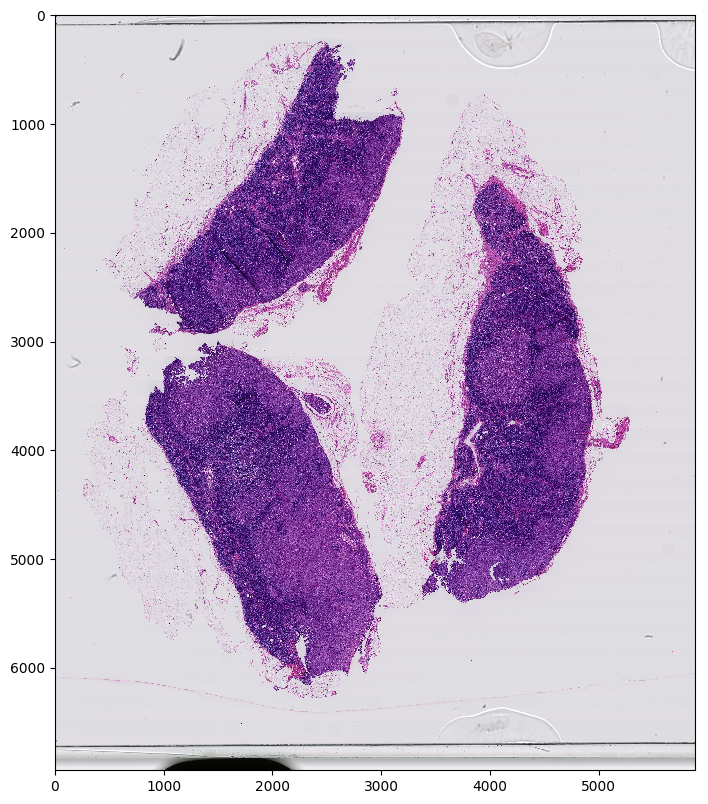

In [0]:
slide_image = read_slide(slides[0], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[0].level_dimensions[4][0], 
                             height=slides[0].level_dimensions[4][1])
print(s_names[0])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_078_mask.tif


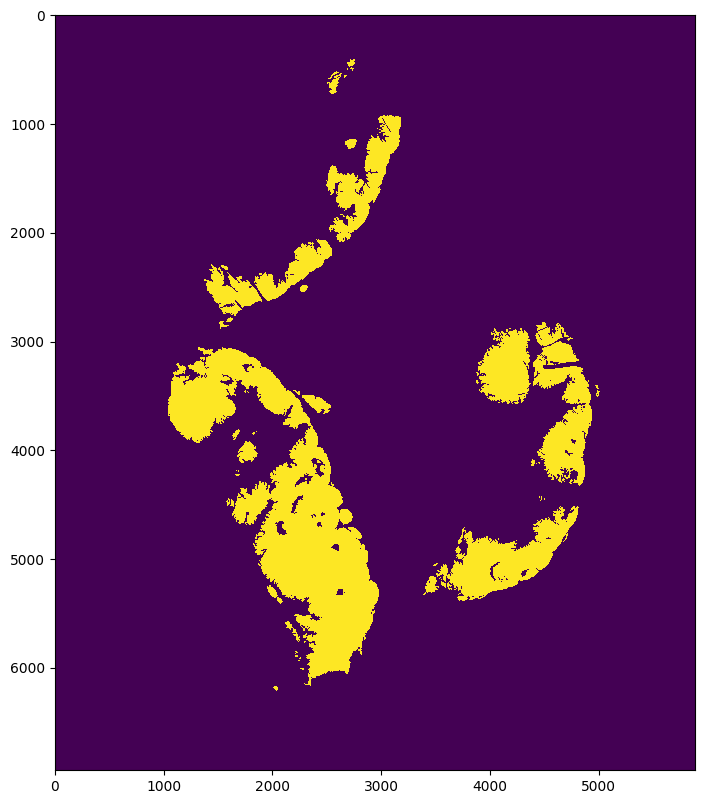

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[0],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[0].level_dimensions[4][0], 
                        height=masks[0].level_dimensions[4][1])
print(m_names[0])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_078.tif and tumor_078_mask.tif


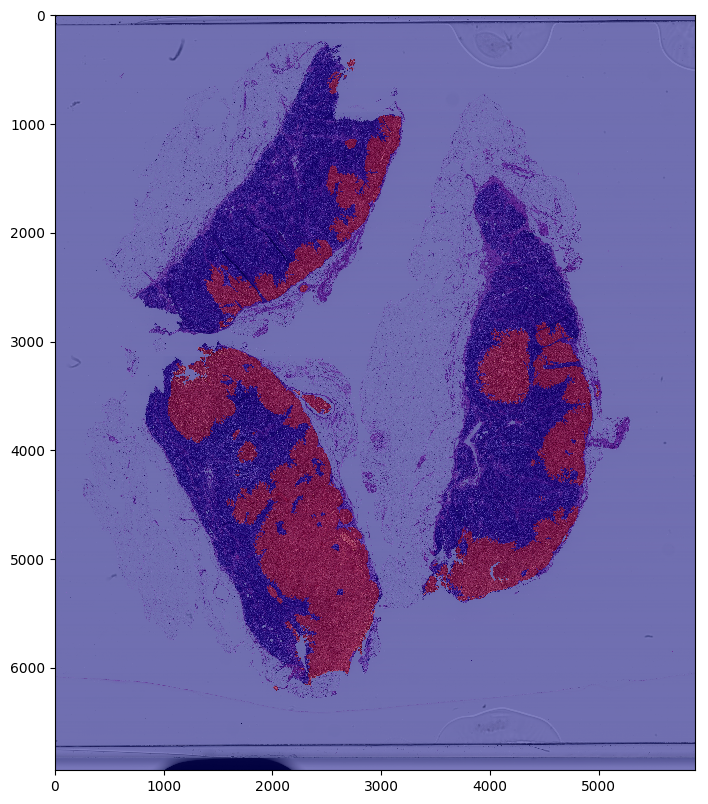

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[0]+" and "+m_names[0])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_094.tif


(6272, 7424, 3)

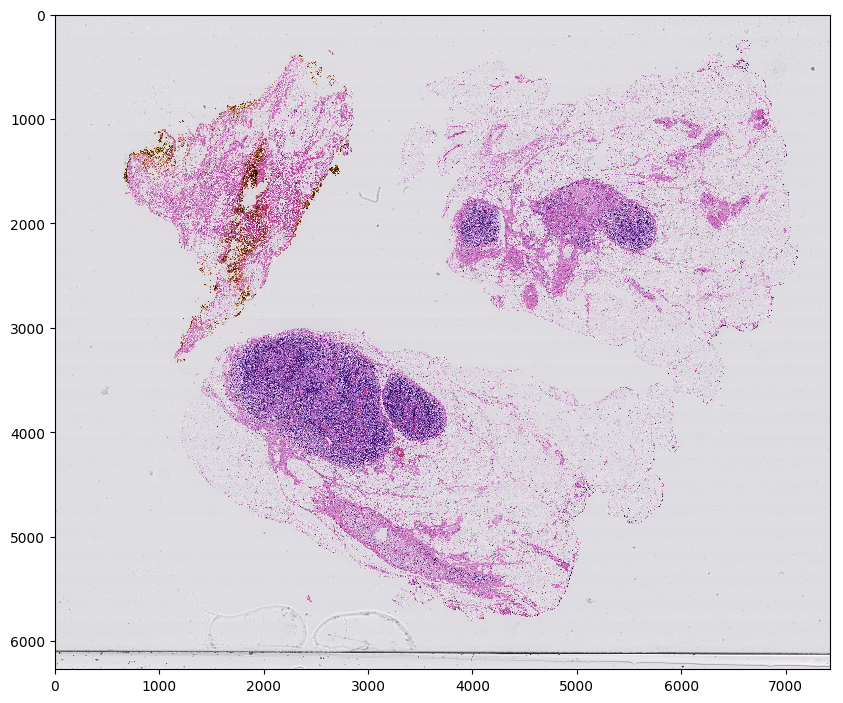

In [0]:
slide_image = read_slide(slides[1], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[1].level_dimensions[4][0], 
                             height=slides[1].level_dimensions[4][1])
print(s_names[1])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_094_mask.tif


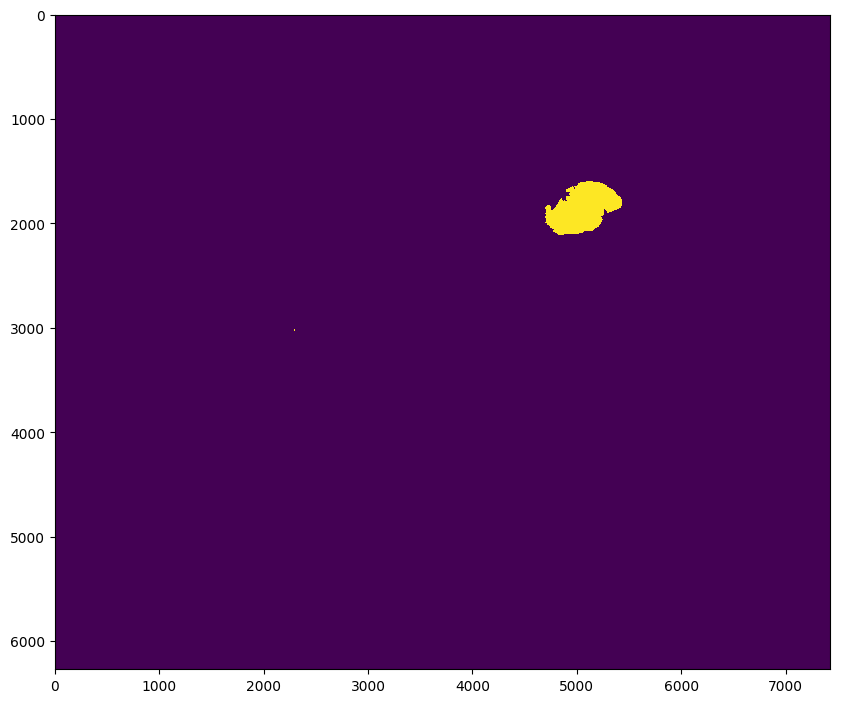

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[1],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[1].level_dimensions[4][0], 
                        height=masks[1].level_dimensions[4][1])
print(m_names[1])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_094.tif and tumor_094_mask.tif


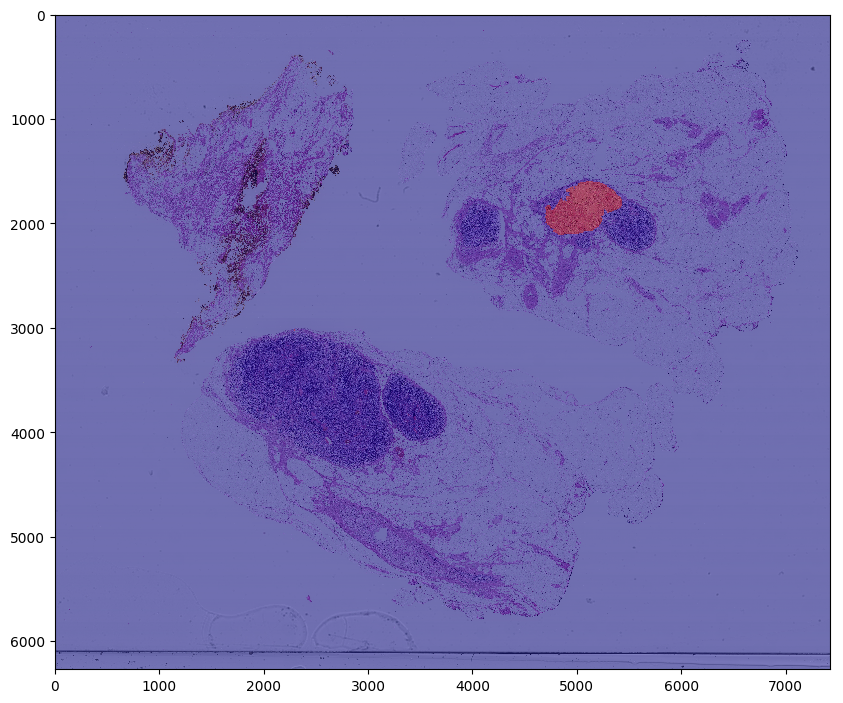

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[1]+" and "+m_names[1])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_081.tif


(6272, 5632, 3)

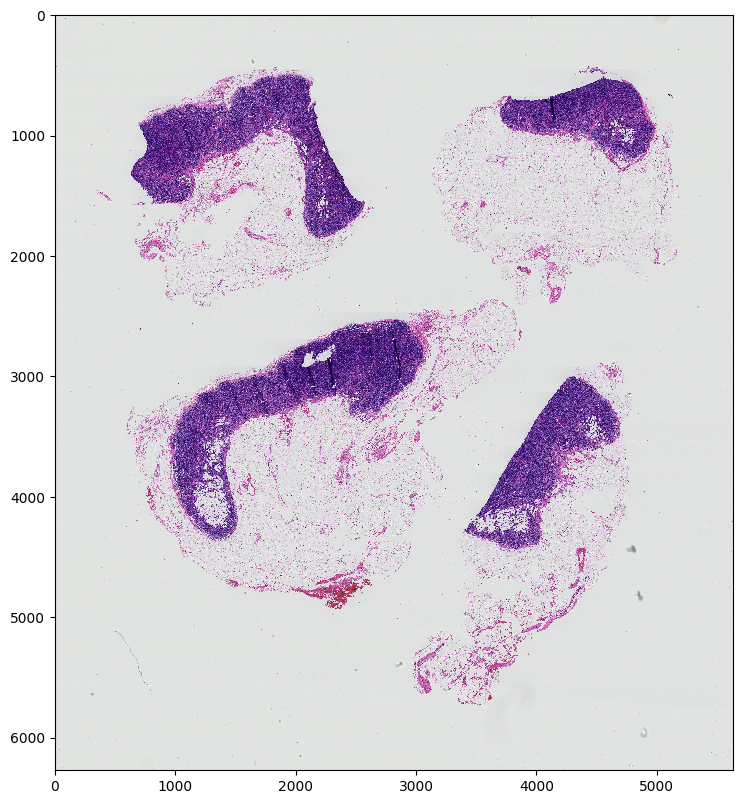

In [0]:
slide_image = read_slide(slides[2], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[2].level_dimensions[4][0], 
                             height=slides[2].level_dimensions[4][1])
print(s_names[2])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_081_mask.tif


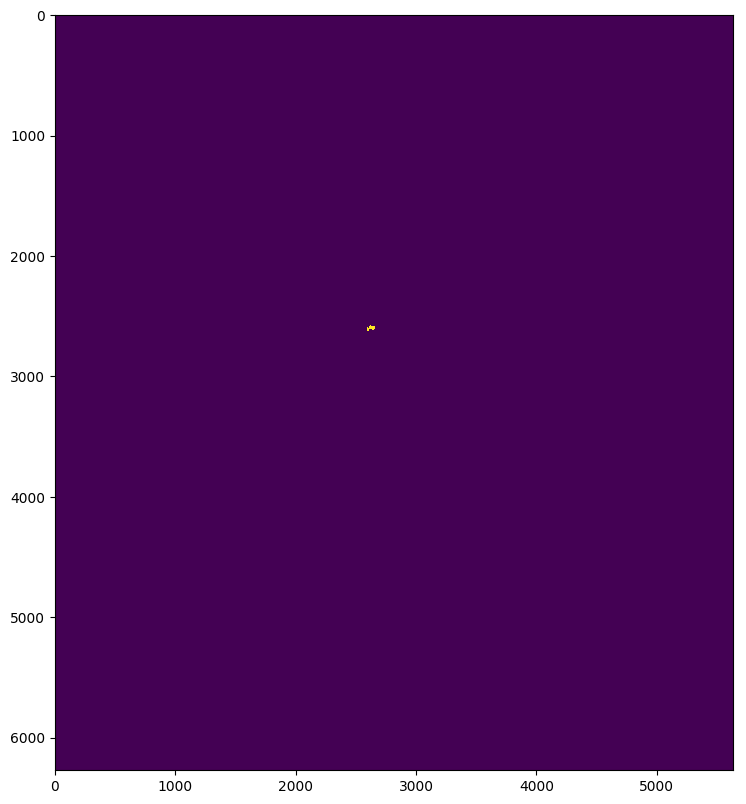

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[2],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[2].level_dimensions[4][0], 
                        height=masks[2].level_dimensions[4][1])
print(m_names[2])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_081.tif and tumor_081_mask.tif


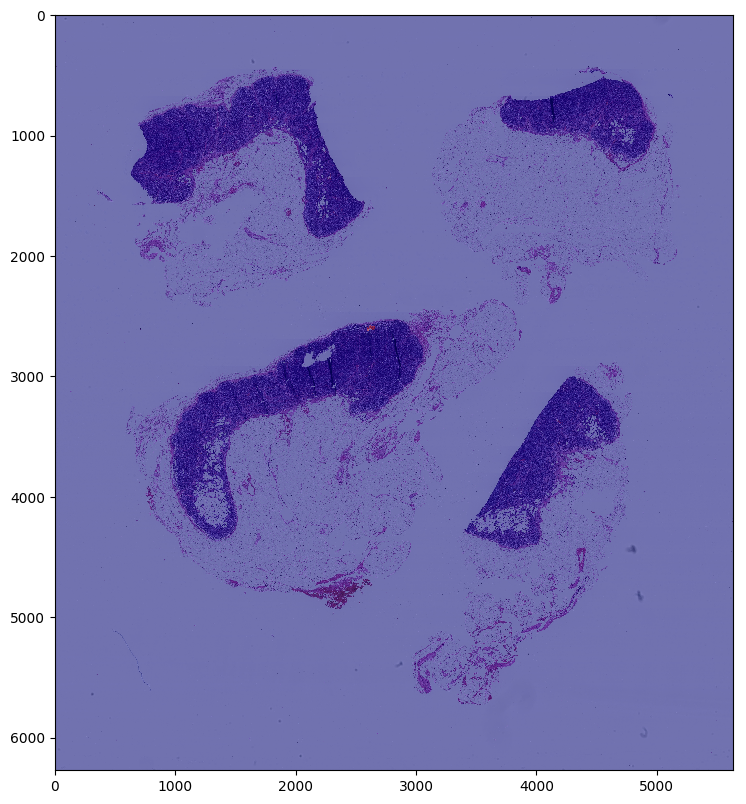

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[2]+" and "+m_names[2])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_091.tif


(3360, 3840, 3)

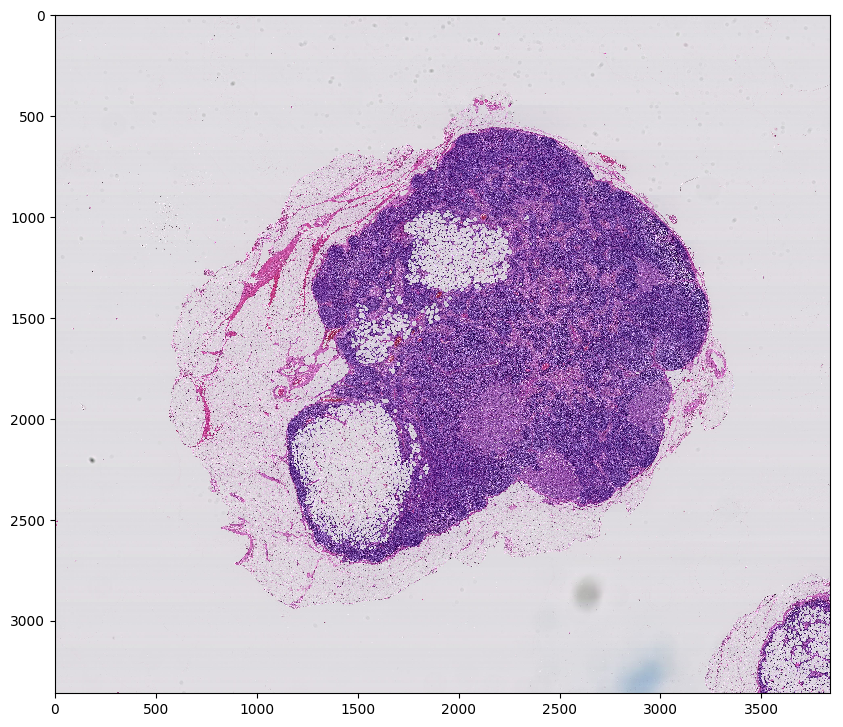

In [0]:
slide_image = read_slide(slides[3], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[3].level_dimensions[4][0], 
                             height=slides[3].level_dimensions[4][1])
print(s_names[3])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_091_mask.tif


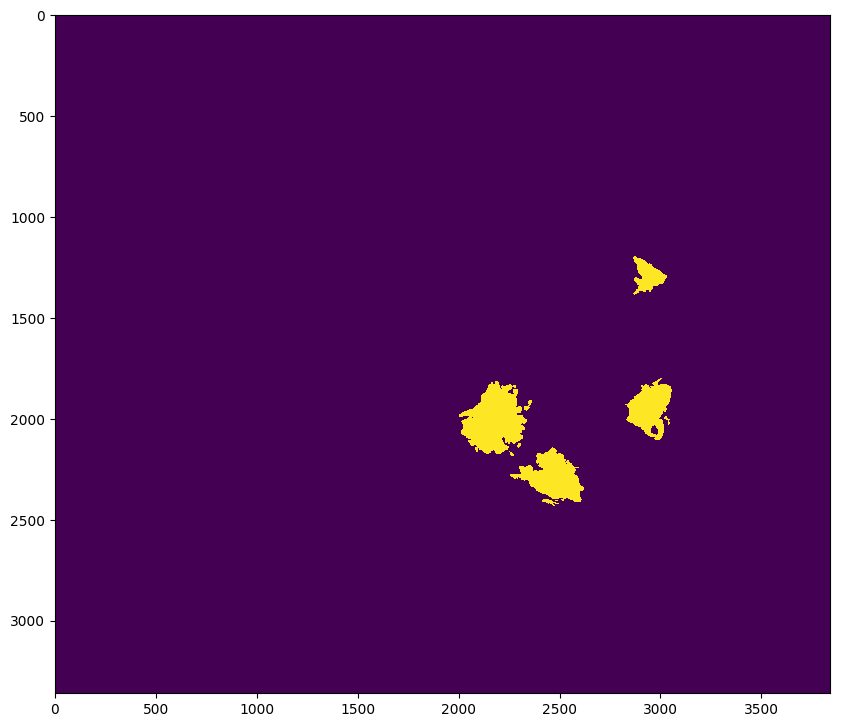

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[3],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[3].level_dimensions[4][0], 
                        height=masks[3].level_dimensions[4][1])
print(m_names[3])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_091.tif and tumor_091_mask.tif


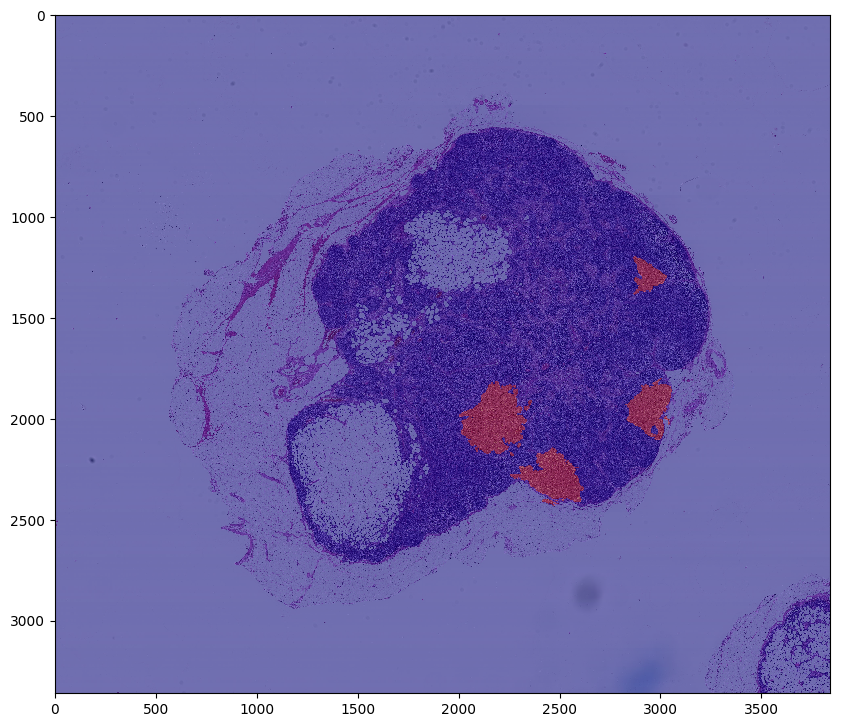

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[3]+" and "+m_names[3])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_096.tif


(4480, 8192, 3)

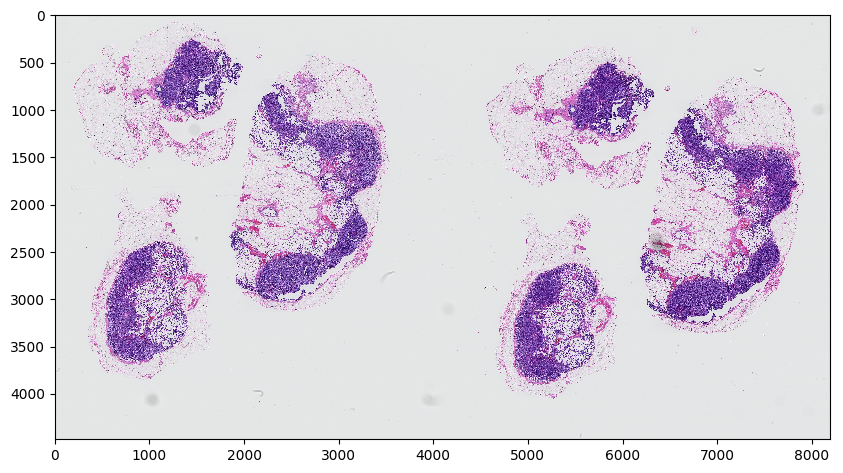

In [0]:
slide_image = read_slide(slides[4], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[4].level_dimensions[4][0], 
                             height=slides[4].level_dimensions[4][1])
print(s_names[4])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_096_mask.tif


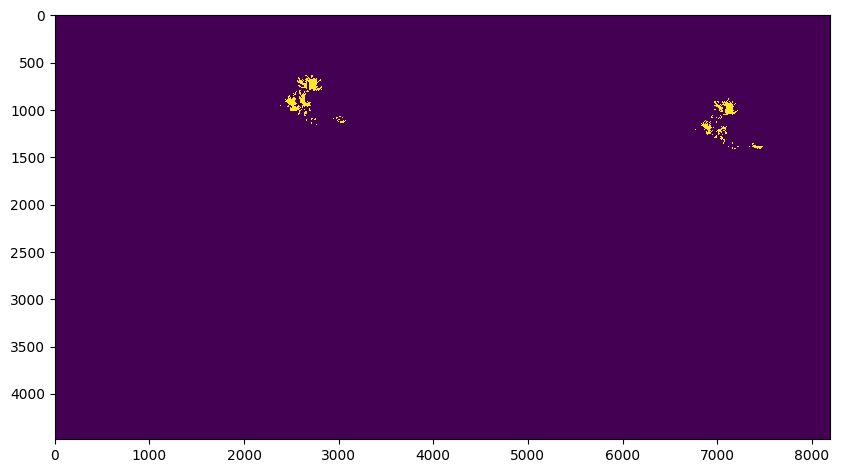

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[4],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[4].level_dimensions[4][0], 
                        height=masks[4].level_dimensions[4][1])
print(m_names[4])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_096.tif and tumor_096_mask.tif


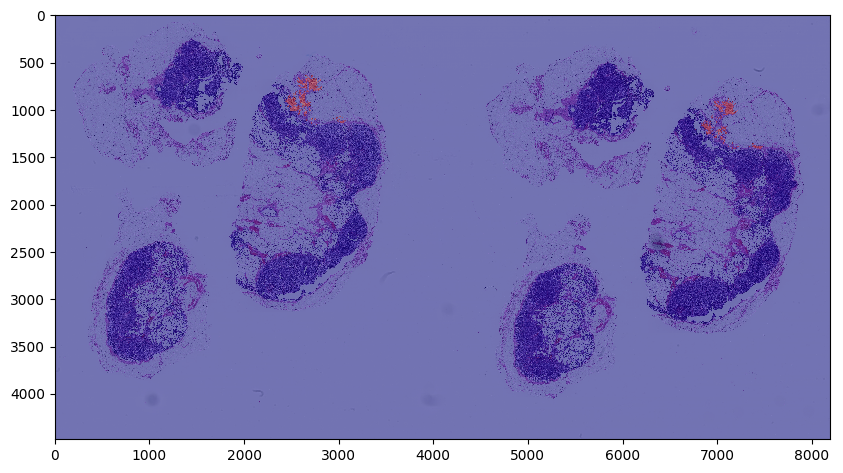

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[4]+" and "+m_names[4])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_075.tif


(4928, 5632, 3)

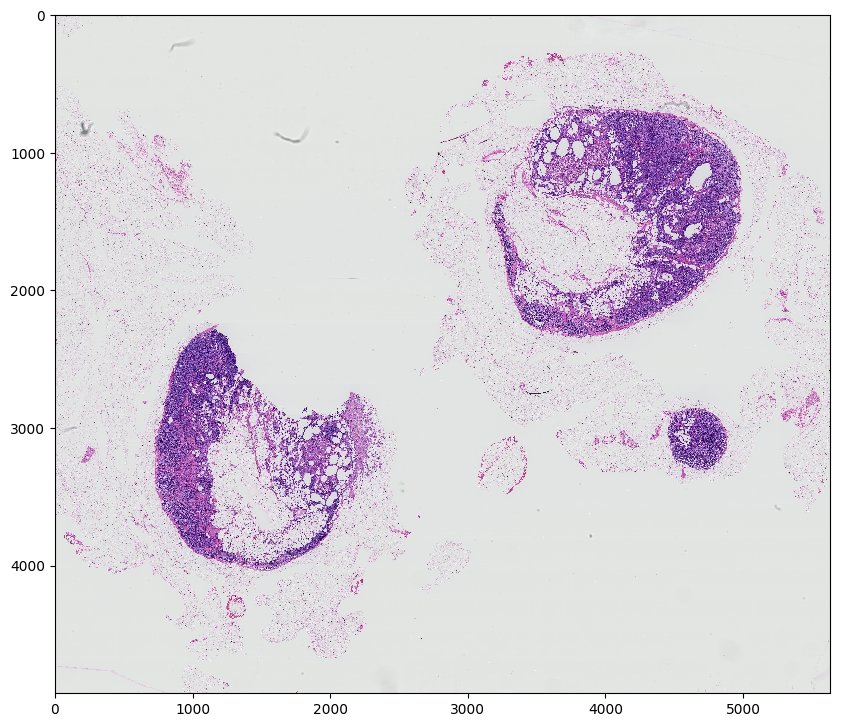

In [0]:
slide_image = read_slide(slides[5], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[5].level_dimensions[4][0], 
                             height=slides[5].level_dimensions[4][1])
print(s_names[5])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_075_mask.tif


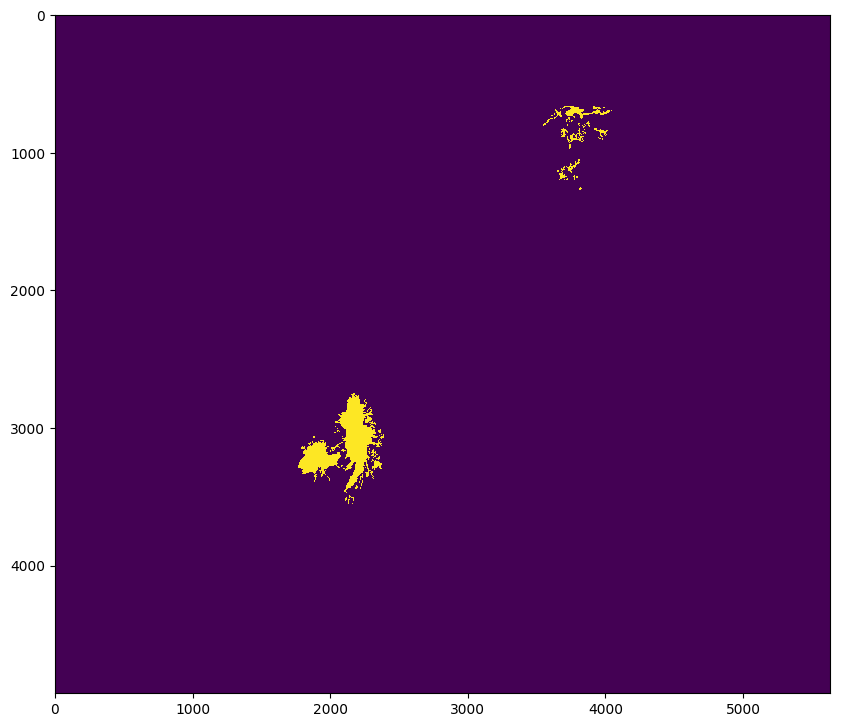

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[5],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[5].level_dimensions[4][0], 
                        height=masks[5].level_dimensions[4][1])
print(m_names[5])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_075.tif and tumor_075_mask.tif


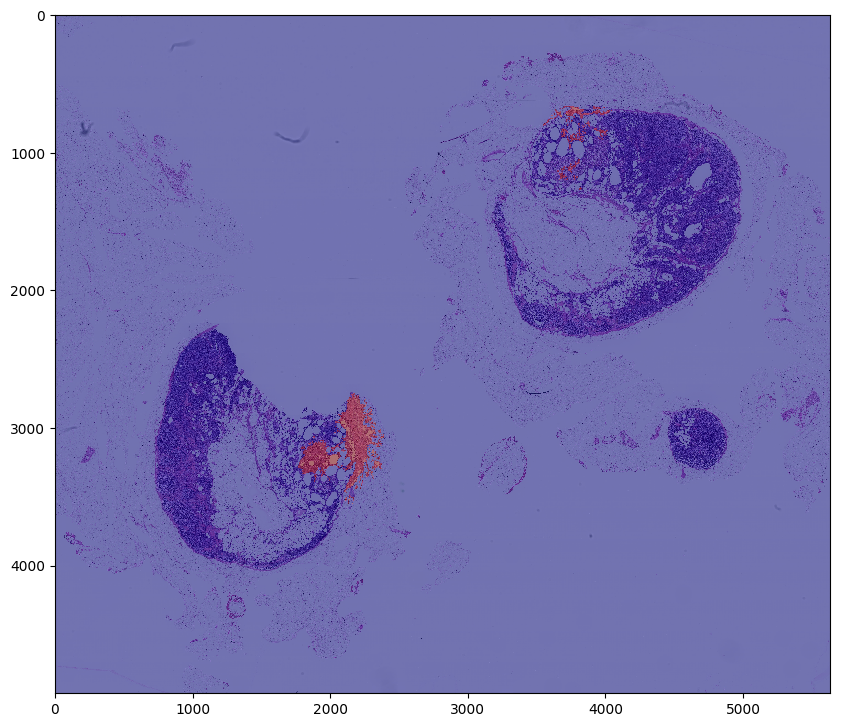

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[5]+" and "+m_names[5])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

tumor_110.tif


(4480, 5888, 3)

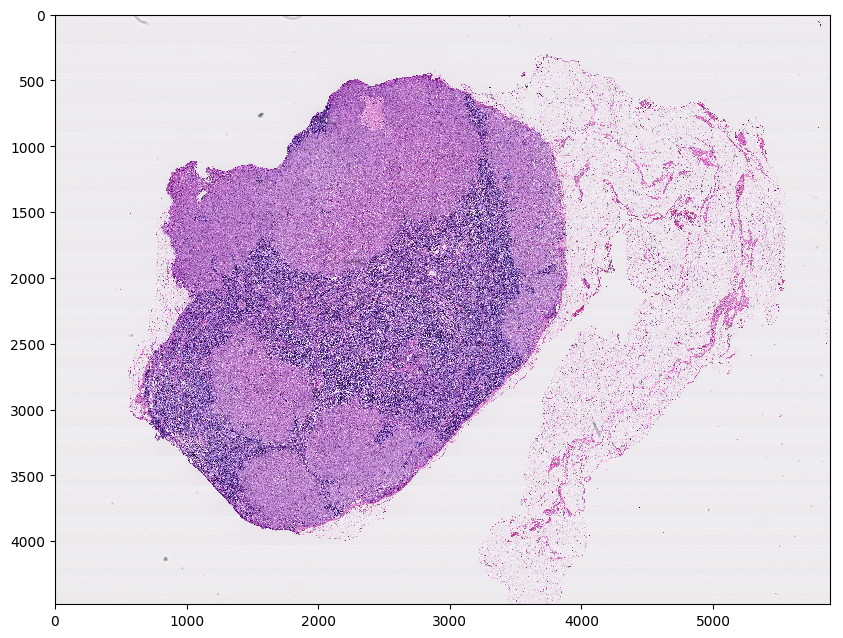

In [0]:
slide_image = read_slide(slides[6], 
                             x=0, 
                             y=0, 
                             level=4, 
                             width=slides[6].level_dimensions[4][0], 
                             height=slides[6].level_dimensions[4][1])
print(s_names[6])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
slide_image.shape

tumor_110_mask.tif


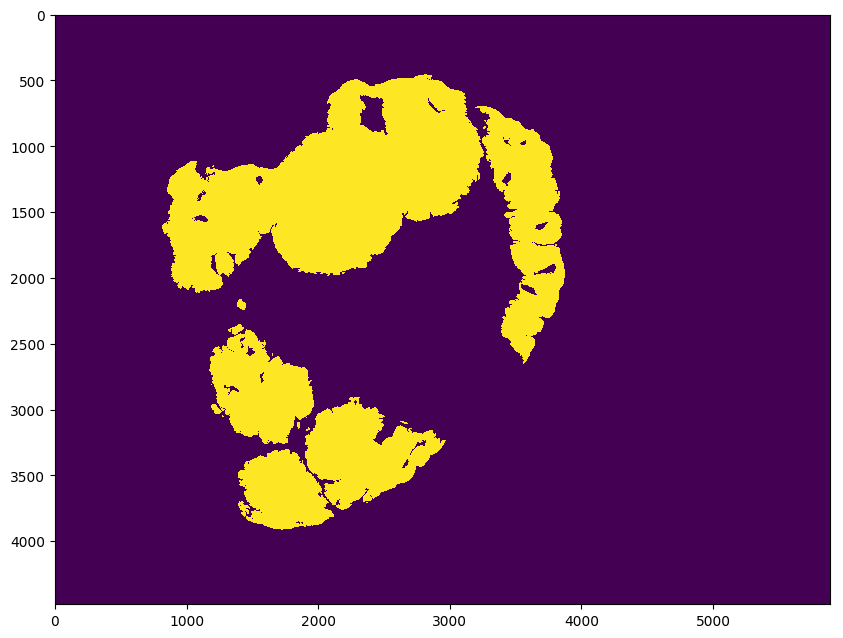

In [0]:
# Example: read the entire mask at the same zoom level
mask_image = read_slide(masks[6],
                        x=0, 
                        y=0, 
                        level=4, 
                        width=masks[6].level_dimensions[4][0], 
                        height=masks[6].level_dimensions[4][1])
print(m_names[6])
# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
# If you skip this step, the mask will be displayed as all black.
mask_image = mask_image[:,:,0]
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(mask_image)

tumor_110.tif and tumor_110_mask.tif


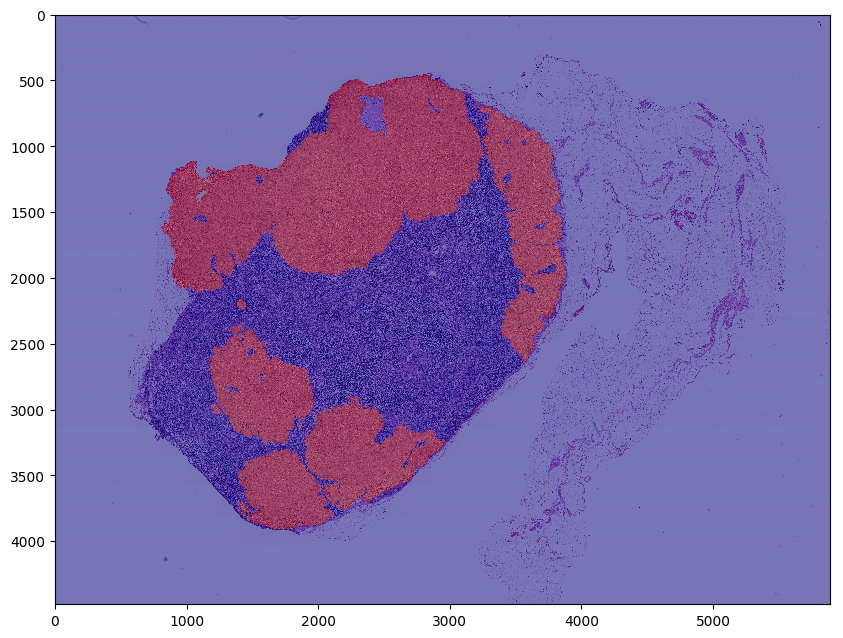

In [0]:
# Overlay them. The idea is that the mask shows the region of the slide that
# contain cancerous cells.
print(s_names[6]+" and "+m_names[6])
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(mask_image, cmap='jet', alpha=0.5) # Red regions contains cancer.

### 1.4. Delete Extra Slides and Verify the Remaining List

After looking at the dataset, I decided to choose this list of slides to train and test the model:

'tumor_078.tif',  'tumor_094.tif',  'tumor_091.tif',  'tumor_075.tif', 'tumor_110.tif'
The criteria for chosing this set: 
1. It passes the dimension verification, which ensures that the dimensions of the mask are equal to the dimensions of the slide at all zoom levels. 
2. It passes the downsampling verification, which ensures that the downsampling it correct.

In [0]:
extra_test_slides = (slides[5],slides[3])
extra_test_masks = (masks[5],masks[3])
del masks[5]
del slides[5]
del s_names[5]
del m_names[5]
del masks[3]
del slides[3]
del s_names[3]
del m_names[3]

print("There are %d slides" % len(s_names))
print("There are %d masks" % len(m_names))
print(s_names)
print(m_names)

There are 5 slides
There are 5 masks
['tumor_091.tif', 'tumor_075.tif', 'tumor_078.tif', 'tumor_094.tif', 'tumor_110.tif']
['tumor_091_mask.tif', 'tumor_075_mask.tif', 'tumor_078_mask.tif', 'tumor_094_mask.tif', 'tumor_110_mask.tif']


## 2. Data Preprocessing

In this section I will convert the files to patches and then split them into training, validation and testing. 

### 2.1. Split Data Into Training and Testing

In [0]:
## I randomly Seperate data into training, testing and validation. 
X_train, X_test, y_train, y_test = train_test_split(slides, masks, test_size=0.20, random_state=15)
print("Training size: %s" %len(X_train))
print("Testing size: %s" %len(X_test))

Training size: 4
Testing size: 1


### 2.2. Helper functions for ignoring non-tissue areas.

In [0]:
# As mentioned in class, we can improve efficiency by ignoring non-tissue areas 
# of the slide. We'll find these by looking for all gray regions.
def find_tissue_pixels(image, intensity=0.8):
    im_gray = rgb2gray(image)
    assert im_gray.shape == (image.shape[0], image.shape[1])
    indices = np.where(im_gray <= intensity)
    return list(zip(indices[0], indices[1]))

def apply_mask(im, mask, color=(255,0,0)):
    masked = np.copy(im)
    for x,y in mask: masked[x][y] = color
    return masked

### 2.3. Create Patches for training

In [0]:
def generate_two_zoom_level_patches(slide, mask, zoom_level1=4, zoom_level2=2, dim=299, not_filtered=False):
    downsample_factor1 = int(slide.level_downsamples[zoom_level1])
    downsample_factor2 = int(slide.level_downsamples[zoom_level2])
    # Extract Max width and height
    width_1 = slide.level_dimensions[zoom_level1][0]
    height_1 = slide.level_dimensions[zoom_level1][1]
    print("Width: %s, Height: %s" %(width_1,height_1))
    # Calculate How many samples do we need on each direction (horizontal and vertical)
    w_samples = width_1//dim
    h_samples = height_1//dim
    print("Total Number of unfiltered patches: %s"%(w_samples*h_samples))
    patches_1 = [] 
    patches_masks_1 = []
    labels = []
    patches_2 = [] 
    patches_masks_2 = []
    xs = []
    ys = []
    # Get Higher Level and patches indexes.
    for j in range(h_samples):
        for i in range(w_samples):
            x1 = i*dim*downsample_factor1
            y1 = j*dim*downsample_factor1
            if(not_filtered or (((x1+(dim*downsample_factor1)) <= slide.level_dimensions[0][0]) and ((y1+(dim*downsample_factor1)) < slide.level_dimensions[0][1]))):
                mask_img1 = read_slide(mask, x = x1, y = y1, level=zoom_level1, width=dim, height=dim)[:,:,0]
                slide_img1 = read_slide(slide, x = x1, y = y1, level=zoom_level1, width=dim, height=dim)
                tissue_pixels = find_tissue_pixels(slide_img1)
                percent_tissue = len(tissue_pixels) / float(slide_img1.shape[0] * slide_img1.shape[0]) * 100
                if percent_tissue > 20 or not_filtered: #Only keep tissue more than 20%
                    #print(i,j)
                    #print ("%s tissue pixels (%.1f percent of the image)" % (len(tissue_pixels), percent_tissue)) 
                    xs.append(x1)
                    ys.append(y1)
                    patches_masks_1.append(mask_img1)
                    patches_1.append(slide_img1)
    # Get Labels and lower zoom
    for i in range(len(patches_1)):
      factor = ((dim-dim//(downsample_factor1//downsample_factor2))//2)*downsample_factor1
      mask_img2 = read_slide(mask, x = (xs[i]+factor), y = (ys[i]+factor), level=zoom_level2, width=dim, height=dim)[:,:,0]
      slide_img2 = read_slide(slide, x = (xs[i]+factor), y = (ys[i]+factor), level=zoom_level2, width=dim, height=dim)
      patches_masks_2.append(mask_img2)
      patches_2.append(slide_img2)
      # Read the label from level 0 128*128
      label_mask = read_slide(mask, x = (xs[i]+((dim-128)//2)*downsample_factor1), y = (ys[i]+((dim-128)//2)*downsample_factor1), level=zoom_level2, width=128, height=128)[:,:,0]
      if np.count_nonzero(label_mask) > 0:
        labels.append(1)
      else:
        labels.append(0)
        
    print("Total Number of filtered patches: %s"%len(patches_1))  
    print("Total Positive:"+str(sum(labels)))    
    return patches_1, patches_masks_1, patches_2, patches_masks_2, labels        

#### 2.3.1. Test Patch Generation 

In [0]:
patches_1, patches_mask_1, patches_2, patches_mask_2, labels = generate_two_zoom_level_patches(slide = slides[0], mask=masks[0], zoom_level1 = 3, zoom_level2 = 2, dim = 299, not_filtered = True)

Width: 7680, Height: 6720
Total Number of unfiltered patches: 550
Total Number of filtered patches: 550
Total Positive:16


In [0]:
np.nonzero(labels)

(array([219, 314, 315, 319, 320, 338, 339, 340, 344, 345, 364, 365, 366,
        390, 391, 392]),)

0

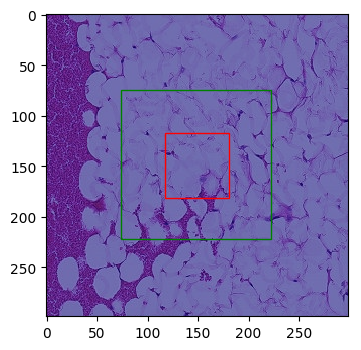

In [0]:
plt.figure(figsize=(4,4), dpi=100)
plt.imshow(patches_1[330])
plt.imshow(patches_mask_1[330], cmap='jet', alpha=0.5)
plt.gca().add_patch(matplotlib.patches.Rectangle((117,117),64, 64,linewidth=1, edgecolor='r', facecolor='none'))
plt.gca().add_patch(matplotlib.patches.Rectangle((74,74),148, 148,linewidth=1, edgecolor='g', facecolor='none'))

labels[330]


0

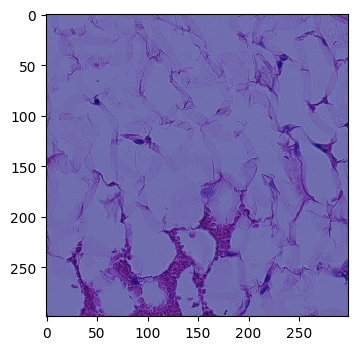

In [0]:
plt.figure(figsize=(4,4), dpi=100)
plt.imshow(patches_2[330])
plt.imshow(patches_mask_2[330], cmap='jet', alpha=0.5)
labels[330]

(array([219, 314, 315, 319, 320, 338, 339, 340, 344, 345, 364, 365, 366,
        390, 391, 392]),)

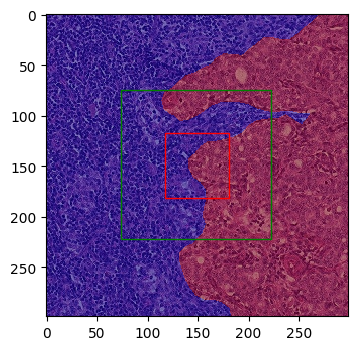

In [0]:
plt.figure(figsize=(4,4), dpi=100)
plt.imshow(patches_1[338])
plt.imshow(patches_mask_1[338], cmap='jet', alpha=0.5)
plt.gca().add_patch(matplotlib.patches.Rectangle((117,117),64, 64,linewidth=1, edgecolor='r', facecolor='none'))
plt.gca().add_patch(matplotlib.patches.Rectangle((74,74),148,148,linewidth=1,edgecolor='g',facecolor='none'))

labels[338]
np.nonzero(labels)

1

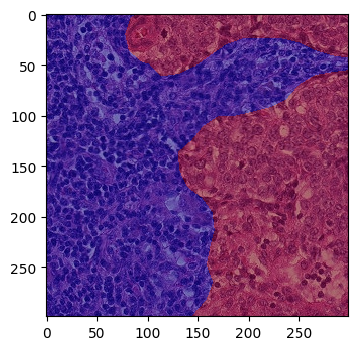

In [0]:
plt.figure(figsize=(4,4), dpi=100)
plt.imshow(patches_2[338])
plt.imshow(patches_mask_2[338], cmap='jet', alpha=0.5)
labels[338]

#### 2.3.2. Save Training Patches to Folder

In [0]:
# Save to folders: train, test, val
def save_patches_two_zooms(directory, X, Y, zoom_level1, zoom_level2, dim):
    for k in range(len(X)): 
        patches_1, patches_mask_1, patches_2, patches_mask_2, labels = generate_two_zoom_level_patches(slide = X[k], mask=Y[k], zoom_level1 = zoom_level1, zoom_level2 = zoom_level2, dim = dim)
        print("Positive Samples: %s Negative Samples: %s" %(sum(labels),(len(labels)-sum(labels))))
        print("-----------")
        for i in range(len(patches_1)):
            matplotlib.image.imsave(directory+ "_1/"+str(labels[i])+"/" +str(k)+ "_" +str(i)+ ".png", patches_1[i])
            matplotlib.image.imsave(directory+ "_2/"+str(labels[i])+"/" +str(k)+ "_" +str(i)+ ".png", patches_2[i])

In [0]:
!ls train_1

ls: cannot access 'train_1': No such file or directory


In [0]:
!rm -rf train_1 train_2

In [0]:

train_dir ="train"

os.mkdir(train_dir+"_1")
os.mkdir(train_dir+'_1/0')
os.mkdir(train_dir+'_1/1')
os.mkdir(train_dir+"_2")
os.mkdir(train_dir+'_2/0')
os.mkdir(train_dir+'_2/1')

In [0]:
save_patches_two_zooms(train_dir, X_train, y_train, 3, 2, 299)

Width: 14848, Height: 12544
Total Number of unfiltered patches: 2009
Total Number of filtered patches: 555
Total Positive:13
Positive Samples: 13 Negative Samples: 542
-----------
Width: 11776, Height: 8960
Total Number of unfiltered patches: 1131
Total Number of filtered patches: 417
Total Positive:206
Positive Samples: 206 Negative Samples: 211
-----------
Width: 11264, Height: 9856
Total Number of unfiltered patches: 1184
Total Number of filtered patches: 216
Total Positive:16
Positive Samples: 16 Negative Samples: 200
-----------
Width: 7680, Height: 6720
Total Number of unfiltered patches: 550
Total Number of filtered patches: 205
Total Positive:16
Positive Samples: 16 Negative Samples: 189
-----------


## 3. Model with two zoom levels

In [0]:
TARGET_SHAPE = 299
train_dir_1 = 'train_1'
train_dir_2 = 'train_2'
BATCH_SIZE = 6
EPOCHS = 30

### 3.1. ROC_AUC metric implementation

In [0]:
def roc_auc(y_true, y_pred):
  if len(np.unique(y_true)) == 1:
    return tf.py_function(accuracy_score, (y_true, tf.math.round(y_pred)), tf.double)
  try:
    return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)
  except ValueError:
    return tf.py_function(accuracy_score, (y_true, tf.math.round(y_pred)), tf.double)

### 3.2. Inception Model Creation

In [0]:
inception_1 = InceptionV3(weights='imagenet',input_shape=(TARGET_SHAPE, TARGET_SHAPE, 3), include_top=False)
# Fine tuning
for layer in inception_1.layers[:249]:
  layer.trainable = False
  layer._name =  layer.name+"_1"
for layer in inception_1.layers[249:]:
  layer.trainable = True
  layer._name =  layer.name+"_1"


inception_2 = InceptionV3(weights='imagenet',input_shape=(TARGET_SHAPE, TARGET_SHAPE, 3), include_top=False)
# Fine tuning
for layer in inception_2.layers[:249]:
  layer.trainable = False
  layer._name =  layer.name+"_2"
for layer in inception_2.layers[249:]:
  layer.trainable = True
  layer._name =  layer.name+"_2"  
    
# Zoom 1 input
zoom_1 = inception_1.output
zoom_1 = GlobalAveragePooling2D()(zoom_1) 
zoom_1 = Dense(128, activation='relu') (zoom_1)

# Zoom 2 input
zoom_2 = inception_2.output
zoom_2 = GlobalAveragePooling2D()(zoom_2) 
zoom_2 = Dense(128, activation='relu') (zoom_2)


# Concatenation
x = Concatenate()([zoom_1, zoom_2])
x = Dense(64, activation='relu')(x)
dropout = Dropout(0.5)(x)
pred = Dense(1, activation='sigmoid')(x)
model = Model(inputs=[inception_1.input, inception_2.input], outputs=pred)

87916544/87910968 [==============================] - 6s 0us/step


### 3.3. Custom Training and Validation Generators

In [0]:
image_gen_train = ImageDataGenerator(rescale=1./255, rotation_range=90, horizontal_flip=True, vertical_flip=True, validation_split=0.2)

from tensorflow.python.keras.utils.data_utils import Sequence
class BalancedImageDataGenerator(Sequence):
    def __init__(self, generator, directory1, directory2, batch_size, dim, subset=None):
        self.batch_index = 0
        self.batch_size = batch_size
        self.generator1 = generator.flow_from_directory(directory1,
                                                        target_size=(
                                                            dim, dim),
                                                        class_mode="binary",
                                                        batch_size=batch_size,
                                                        shuffle=True,
                                                        subset=subset,
                                                        seed = 12)
        self.generator2 = generator.flow_from_directory(directory2,
                                                        target_size=(
                                                            dim, dim),
                                                        class_mode="binary",
                                                        batch_size=batch_size,
                                                        shuffle=True,
                                                        subset=subset,
                                                        seed = 12)
        self.n = self.generator1.samples
        
    def reset(self):
        self.batch_index = 0

    def __len__(self):
        return (self.n + self.batch_size - 1) // self.batch_size

    def __getitem__(self, idx):
        X1, Y1 = self.generator1.next()
        X2, Y1 = self.generator2.next()

        X1, X2, Y = self.balance_batch(X1,X2,Y1)

        return (X1, X2), Y
      
    def balance_batch(self, X, X2, Y):
      # Balance
      x_1_1 = X[np.nonzero(Y == 1.)]
      x_0_1 = X[np.nonzero(Y == 0.)]
      x_1_2 = X2[np.nonzero(Y == 1.)]
      x_0_2 = X2[np.nonzero(Y == 0.)]
      
      if len(x_1_1) == 0. or len(x_0_1) == 0.:
        while len(x_1_1) == 0. or len(x_0_1) == 0.:
          X_1, Y1 = self.generator1.next()
          X_2, Y1 = self.generator2.next()
          X = np.concatenate([X, X_1], axis=0)
          X2 = np.concatenate([X2, X_2], axis=0)
          Y = np.concatenate([Y, Y1], axis=0)
          x_1_1 = X[np.nonzero(Y == 1.)]
          x_0_1 = X[np.nonzero(Y == 0.)]
          x_1_2 = X2[np.nonzero(Y == 1.)]
          x_0_2 = X2[np.nonzero(Y == 0.)]
      
      half_batch = self.batch_size//2
      X_0_sampled_1 = x_0_1[np.random.choice(len(x_0_1),size = half_batch, replace = True)]
      X_1_sampled_1 = x_1_1[np.random.choice(len(x_1_1),size = half_batch, replace = True)]
      
      X_0_sampled_2 = x_0_2[np.random.choice(len(x_0_2),size = half_batch, replace = True)]
      X_1_sampled_2 = x_1_2[np.random.choice(len(x_1_2),size = half_batch, replace = True)]
      X1_batch = np.concatenate((X_0_sampled_1, X_1_sampled_1)) 
      X2_batch = np.concatenate((X_0_sampled_2, X_1_sampled_2))
      Y_batch = np.concatenate(([0.]*(half_batch), [1.]*(half_batch)))
      # Shuffle
      indices = np.arange(Y_batch.shape[0])
      np.random.shuffle(indices)

      X1_batch = X1_batch[indices]
      X2_batch = X2_batch[indices]
      Y_batch = Y_batch[indices]
      return X1_batch, X2_batch, Y_batch

In [0]:
train_data_two_gen = BalancedImageDataGenerator(image_gen_train, train_dir_1, train_dir_2, BATCH_SIZE, 299, 'training')
val_data_two_gen = BalancedImageDataGenerator(image_gen_train, train_dir_1, train_dir_2, BATCH_SIZE, 299, 'validation')

Found 1115 images belonging to 2 classes.
Found 1115 images belonging to 2 classes.
Found 278 images belonging to 2 classes.
Found 278 images belonging to 2 classes.


In [0]:
sgd = optimizers.SGD(lr=1e-4, decay=1e-6, momentum=0.9, nesterov=True)
rmsprop = optimizers.RMSprop(lr=0.05, decay=0.9, momentum=0.9, epsilon= 1)
adam = optimizers.Adam(lr=3e-4)
filepath="weights-improvement-{epoch:02d}-{val_acc:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]

model.compile(loss='binary_crossentropy',
              optimizer=adam, metrics=['acc', roc_auc])

#### Model Summary

In [0]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5_1 (InputLayer)          [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
input_6_2 (InputLayer)          [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d_376_1 (Conv2D)           (None, 149, 149, 32) 864         input_5_1[0][0]                  
__________________________________________________________________________________________________
conv2d_470_2 (Conv2D)           (None, 149, 149, 32) 864         input_6_2[0][0]                  
____________________________________________________________________________________________

#### 3.3.1. Verify Generator Output

In [0]:
# Make sure the generator is working as it should be
input_1 = 0
output_1 = 0
for x1,y in train_data_two_gen:
  print(x1[0].shape)
  print(x1[1].shape)
  print(y)
  input_1 = x1
  output_1 = y
  break

(6, 299, 299, 3)
(6, 299, 299, 3)
[1. 0. 1. 0. 0. 1.]


### 3.4. Overfit one patch to make sure the model is learning

In [0]:
# This cell has been commented out to avoid running it and overtraining the model. 
#overfit one batch (not from generator): 
#history = model.fit(
#    ([patches_1[330], patches_1[338]], [patches_2[330], patches_2[338]]), 
#    [labels[330], labels[338]],
#    epochs=EPOCHS,
#    verbose=1)

Epoch 1/30
2/2 [==============================] - 10s 5s/sample - loss: 0.9532 - acc: 0.5000
Epoch 2/30
2/2 [==============================] - 0s 36ms/sample - loss: 0.0210 - acc: 1.0000
Epoch 3/30
2/2 [==============================] - 0s 35ms/sample - loss: 0.0059 - acc: 1.0000
Epoch 4/30
2/2 [==============================] - 0s 33ms/sample - loss: 0.0023 - acc: 1.0000
Epoch 5/30
2/2 [==============================] - 0s 33ms/sample - loss: 0.0010 - acc: 1.0000
Epoch 6/30
2/2 [==============================] - 0s 33ms/sample - loss: 5.0370e-04 - acc: 1.0000
Epoch 7/30
2/2 [==============================] - 0s 36ms/sample - loss: 2.6433e-04 - acc: 1.0000
Epoch 8/30
2/2 [==============================] - 0s 34ms/sample - loss: 1.4808e-04 - acc: 1.0000
Epoch 9/30
2/2 [==============================] - 0s 37ms/sample - loss: 8.7995e-05 - acc: 1.0000
Epoch 10/30
2/2 [==============================] - 0s 33ms/sample - loss: 5.4492e-05 - acc: 1.0000
Epoch 11/30
2/2 [=======================

In [0]:
model.predict(([patches_1[330]], [patches_2[330]]))

array([0])

In [0]:
labels[330]

0

In [0]:
model.predict(([patches_1[338]], [patches_2[338]]))

array([1])

### 3.5. Overfit one generator batch to make sure the model is learning on input from the generator

In [0]:
# This cell has been commented out to avoid running it and overtraining the model. 
#overfit one batch from generator: 
#history = model.fit(
#    input_1,
#    output_1,
#    epochs=EPOCHS,
#    verbose=1,
#    batch_size=BATCH_SIZE)

Epoch 1/30
6/6 [==============================] - 7s 1s/sample - loss: 0.8015 - acc: 0.5000
Epoch 2/30
6/6 [==============================] - 0s 31ms/sample - loss: 0.0959 - acc: 1.0000
Epoch 3/30
6/6 [==============================] - 0s 22ms/sample - loss: 0.0139 - acc: 1.0000
Epoch 4/30
6/6 [==============================] - 0s 18ms/sample - loss: 0.0039 - acc: 1.0000
Epoch 5/30
6/6 [==============================] - 0s 19ms/sample - loss: 0.0015 - acc: 1.0000
Epoch 6/30
6/6 [==============================] - 0s 18ms/sample - loss: 6.3283e-04 - acc: 1.0000
Epoch 7/30
6/6 [==============================] - 0s 18ms/sample - loss: 3.0837e-04 - acc: 1.0000
Epoch 8/30
6/6 [==============================] - 0s 19ms/sample - loss: 1.6377e-04 - acc: 1.0000
Epoch 9/30
6/6 [==============================] - 0s 20ms/sample - loss: 9.3992e-05 - acc: 1.0000
Epoch 10/30
6/6 [==============================] - 0s 18ms/sample - loss: 5.7154e-05 - acc: 1.0000
Epoch 11/30
6/6 [========================

In [0]:
preds = model.predict(input_1)
threshold = 0.01

np.where(preds <= threshold, 0, 1)

array([[1],
       [0],
       [1],
       [0],
       [0],
       [1]])

In [0]:
output_1

array([1., 0., 1., 0., 0., 1.])

### 3.6. Train Model

In [0]:
history = model.fit_generator(
  train_data_two_gen,
  epochs=EPOCHS,
  steps_per_epoch = train_data_two_gen.n // BATCH_SIZE,
  validation_data = val_data_two_gen, 
  validation_steps = val_data_two_gen.n // BATCH_SIZE,
  verbose=1,
  callbacks=callbacks_list)

Epoch 1/30
184/185 [============================>.] - ETA: 0s - loss: 0.1427 - acc: 0.9529 - roc_auc: 0.9529
Epoch 00001: val_acc improved from -inf to 0.59783, saving model to weights-improvement-01-0.60.hdf5
185/185 [==============================] - 156s 843ms/step - loss: 0.1453 - acc: 0.9514 - roc_auc: 0.9514 - val_loss: 1.7074 - val_acc: 0.5978 - val_roc_auc: 0.5978
Epoch 2/30
184/185 [============================>.] - ETA: 0s - loss: 0.0882 - acc: 0.9683 - roc_auc: 0.9683
Epoch 00002: val_acc improved from 0.59783 to 0.85507, saving model to weights-improvement-02-0.86.hdf5
185/185 [==============================] - 109s 591ms/step - loss: 0.0878 - acc: 0.9685 - roc_auc: 0.9685 - val_loss: 0.4399 - val_acc: 0.8551 - val_roc_auc: 0.8551
Epoch 3/30
184/185 [============================>.] - ETA: 0s - loss: 0.0883 - acc: 0.9692 - roc_auc: 0.9692
Epoch 00003: val_acc did not improve from 0.85507
185/185 [==============================] - 108s 586ms/step - loss: 0.0879 - acc: 0.9694 

In [0]:
# Save model after training
model.save('inception_v3_model_two_zooms.h5')  # creates a HDF5 file 'my_model.h5'

### 3.7. Training Accuracy and Loss Plots 

Classification results:


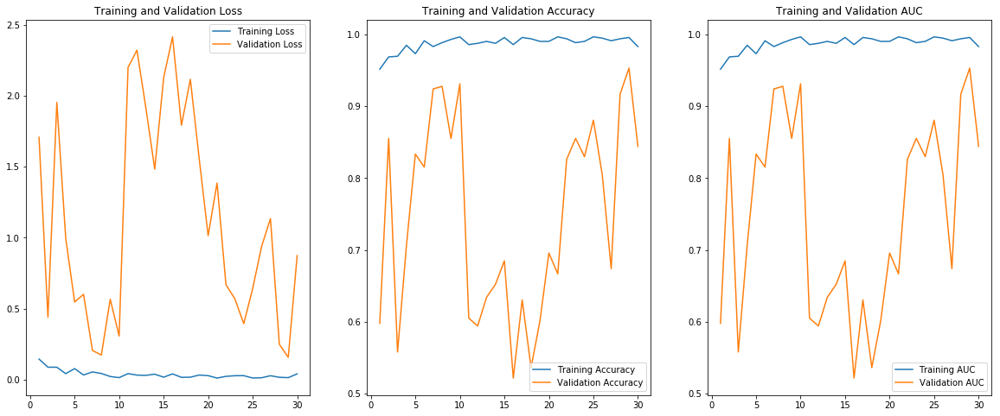

In [0]:
print("Classification results:")

acc = history.history['acc']
val_acc = history.history['val_acc']

loss = history.history['loss']
val_loss = history.history['val_loss']

auc = history.history['roc_auc']
val_auc = history.history['val_roc_auc']

epochs_range = range(1, EPOCHS+1)

plt.figure(figsize=(20, 8))
plt.subplot(1, 3, 3)
plt.plot(epochs_range, auc, label='Training AUC')
plt.plot(epochs_range, val_auc, label='Validation AUC')
plt.legend(loc='lower right')
plt.title('Training and Validation AUC')

plt.subplot(1, 3, 2)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 3, 1)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()



## 4. Heatmap generation

### 4.1. Load Trained Model Weights 

In [0]:
# Write a script that takes your trained model and a testing image,
# and outputs a heat map showing the cancerous regions.
adam = optimizers.Adam(lr=3e-4)
# load weights
model.load_weights("weights-improvement-29-0.95.hdf5")
# Compile model (required to make predictions)
model.compile(loss='binary_crossentropy',
              optimizer=adam, metrics=['acc', roc_auc])

In [0]:
#model = load_model('inception_v3_model.h5', custom_objects={'roc_auc': roc_auc})

### 4.2. Predict and Generate Heatmap

In [0]:
def generate_heatmap(slide, mask, zoom_level1=3, zoom_level2=2, dim=299, stride=8, threshold=0.5):
    downsample_factor1 = int(slide.level_downsamples[zoom_level1])
    downsample_factor2 = int(slide.level_downsamples[zoom_level2])
    # Extract Max width and height
    width_1 = slide.level_dimensions[7][0]
    height_1 = slide.level_dimensions[7][1]
    print("Width: %s, Height: %s" %(width_1,height_1))
    # Calculate How many samples do we need on each direction (horizontal and vertical)
    w_samples = width_1//stride 
    h_samples = height_1//stride
    print("Total Number of patches: %s"%(w_samples*h_samples))
    labels = []
    predictions = []
    slide_image = read_slide(slide, 
                             x=0, 
                             y=0, 
                             level=7, 
                             width=slide.level_dimensions[7][0], 
                             height=slide.level_dimensions[7][1])
    actual_mask = np.zeros((slide_image.shape[0], slide_image.shape[1]))
    predicted_mask = np.zeros((slide_image.shape[0], slide_image.shape[1]))
    seven_factor = 16
    # Get Higher Level and patches indexes.
    for j in range(0,slide_image.shape[1], stride):
          for i in range(0,slide_image.shape[0], stride):
            x1 = i*downsample_factor1*seven_factor
            y1 = j*downsample_factor1*seven_factor
            slide_img1 = read_slide(slide, x = x1, y = y1, level=zoom_level1, width=dim, height=dim)
            tissue_pixels = find_tissue_pixels(slide_img1)
            percent_tissue = len(tissue_pixels) / float(slide_img1.shape[0] * slide_img1.shape[0]) * 100
            slide_img1 = slide_img1/255.
            if percent_tissue > 20: #Only predict when tissue more than 20%
              factor = ((dim-dim//(downsample_factor1//downsample_factor2))//2)*downsample_factor1
              slide_img2 = read_slide(slide, x = (x1+factor), y = (y1+factor), level=zoom_level2, width=dim, height=dim)/255.
              prediction = model.predict(([slide_img1, np.fliplr(slide_img1), np.flipud(slide_img1), np.rot90(slide_img1)],[slide_img2, np.fliplr(slide_img2), np.flipud(slide_img2), np.rot90(slide_img2)]), verbose=0)
              predictions.append(np.mean(prediction))
              if prediction[0] > threshold:
                  predicted_mask[i:i+stride , j:j+stride] = prediction[0]
              else:
                  predicted_mask[i:i+stride , j:j+stride] = 0
              label_mask = read_slide(mask, x = (x1+((dim-128)//2)*downsample_factor1), y = (y1+((dim-128)//2)*downsample_factor1), level=zoom_level2, width=128, height=128)[:,:,0]
              if np.count_nonzero(label_mask) > 0:
                labels.append(1)
                actual_mask[i:i+stride , j:j+stride] = 1
              else:
                labels.append(0)
                actual_mask[i:i+stride , j:j+stride] = 0

              
    print("Total Number of filtered patches: %s"%len(labels))  
    print("Total Positive:"+str(sum(labels)))    
    return slide_image, actual_mask.T, predicted_mask.T, predictions, labels   

In [0]:
slide_img, actual_mask, predicted_mask, predictions, labels = generate_heatmap(X_test[0], y_test[0], zoom_level1=3, zoom_level2=2, dim=299, stride=8, threshold=0.5)

Width: 736, Height: 868
Total Number of patches: 9936
Total Number of filtered patches: 5068
Total Positive:1189


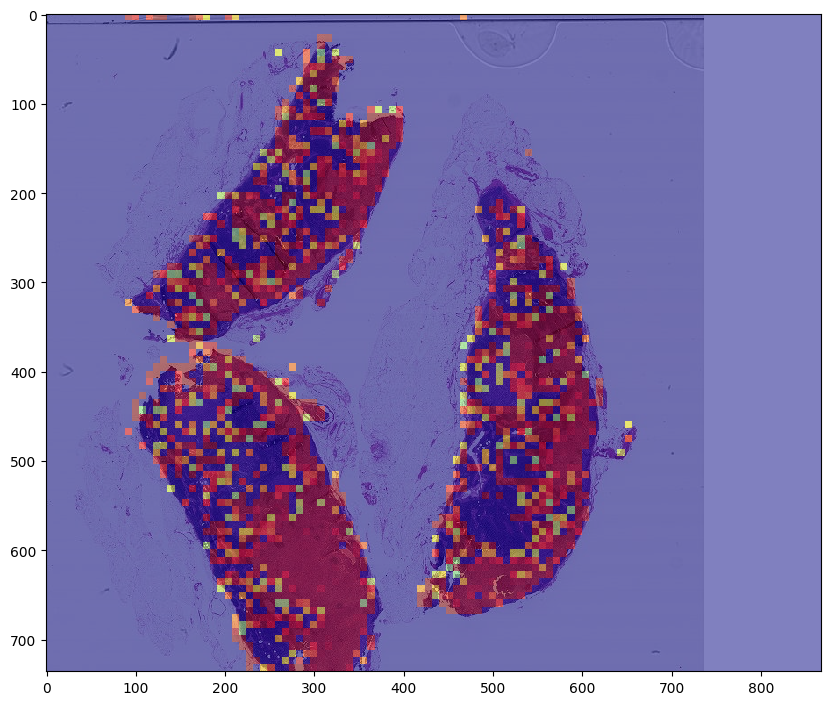

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(predicted_mask, cmap='jet', alpha=0.5) # Red regions contains cancer.

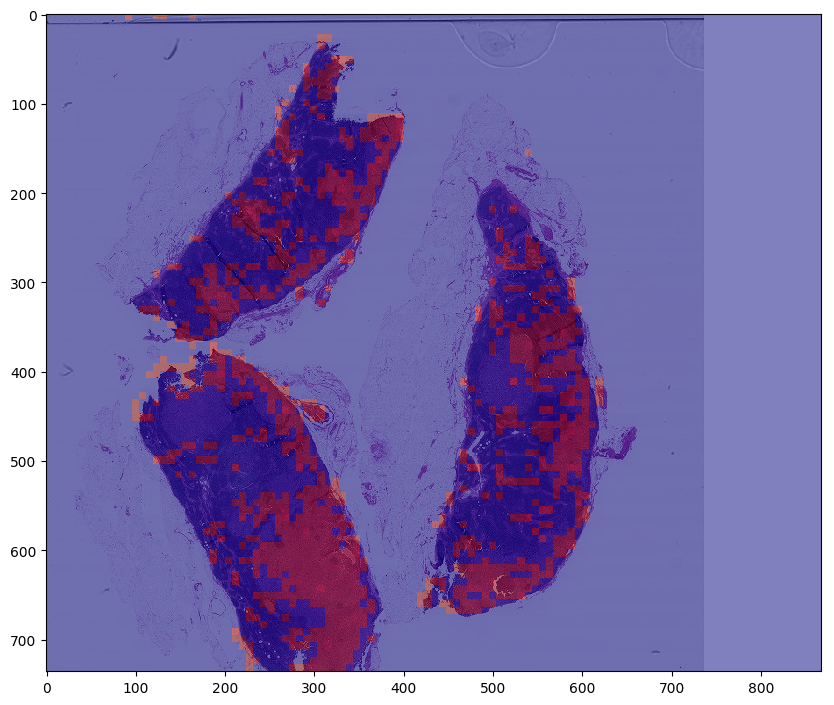

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(np.where(predicted_mask >=0.95, predicted_mask, 0), cmap='jet', alpha=0.5) # Red regions contains cancer.


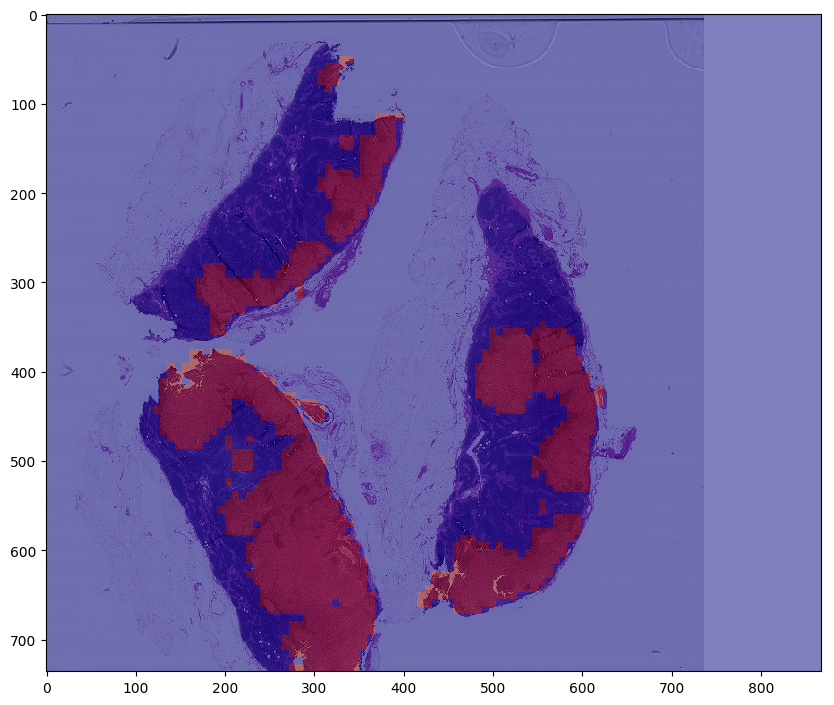

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_image)
plt.imshow(actual_mask, cmap='jet', alpha=0.5) # Red regions contains cancer.

### 4.3 Test the model on two extra images

In [0]:
slide_img_2, actual_mask_2, predicted_mask_2, predictions_2, labels_2 = generate_heatmap(extra_test_slides[0], extra_test_masks[0], zoom_level1=3, zoom_level2=2, dim=299, stride=8, threshold=0.5)

Width: 1024, Height: 560
Total Number of patches: 8960
Total Number of filtered patches: 5334
Total Positive:35


In [0]:
slide_img_3, actual_mask_3, predicted_mask_3, predictions_3, labels_3 = generate_heatmap(extra_test_slides[1], extra_test_masks[1], zoom_level1=3, zoom_level2=2, dim=299, stride=8, threshold=0.5)

Width: 704, Height: 784
Total Number of patches: 8624
Total Number of filtered patches: 2746
Total Positive:1


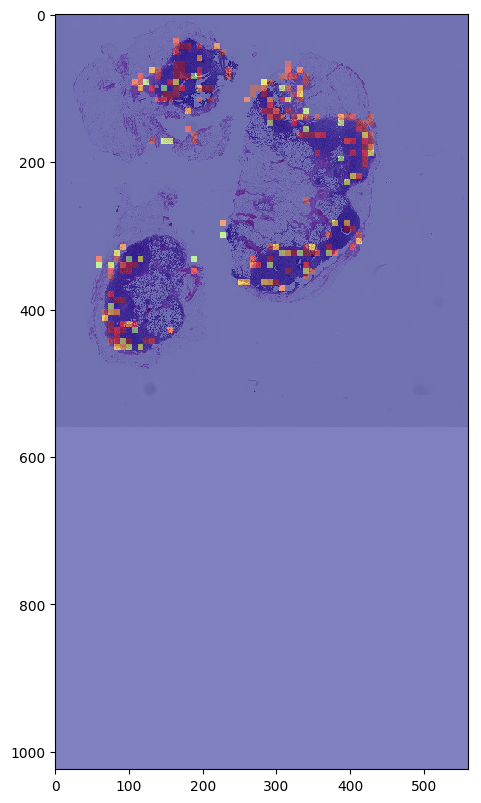

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_2)
plt.imshow(predicted_mask_2, cmap='jet', alpha=0.5) # Red regions contains cancer.

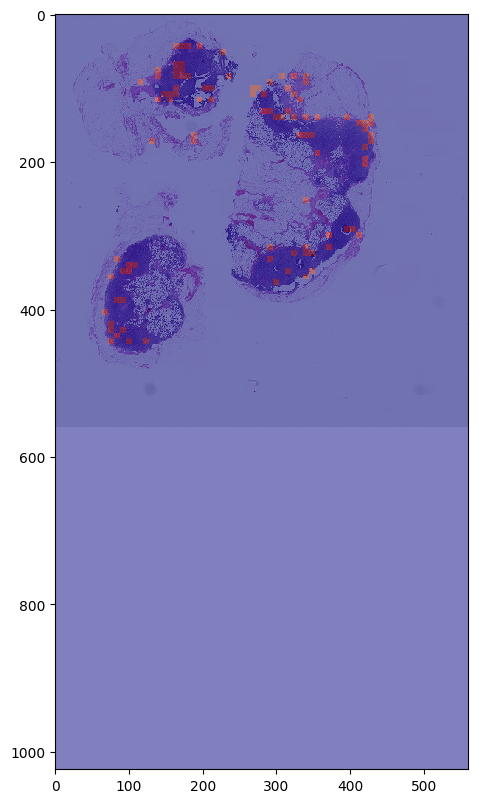

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_2)
plt.imshow(np.where(predicted_mask_2 >=0.95, predicted_mask_2, 0), cmap='jet', alpha=0.5) # Red regions contains cancer.


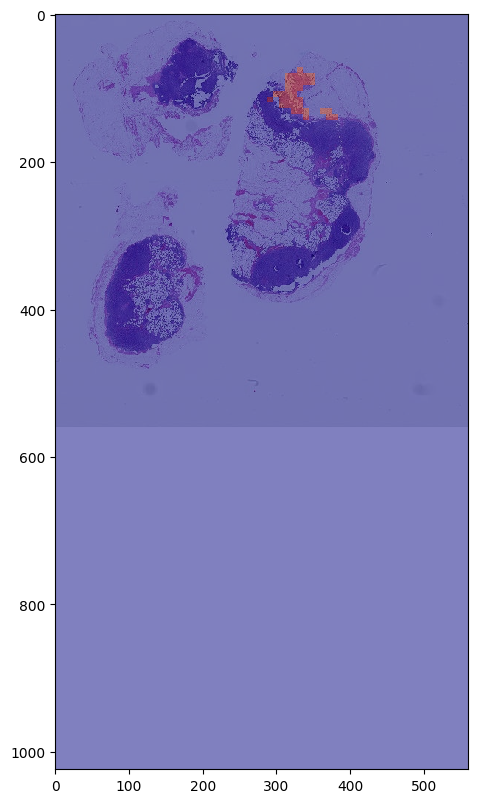

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_2)
plt.imshow(actual_mask_2, cmap='jet', alpha=0.5) # Red regions contains cancer.

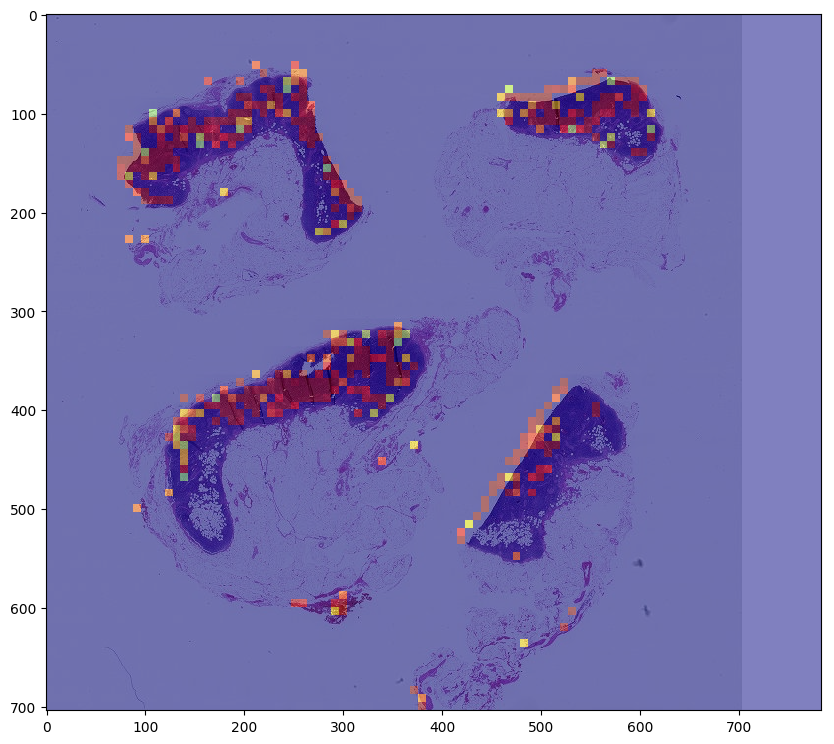

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_3)
plt.imshow(predicted_mask_3, cmap='jet', alpha=0.5) # Red regions contains cancer.

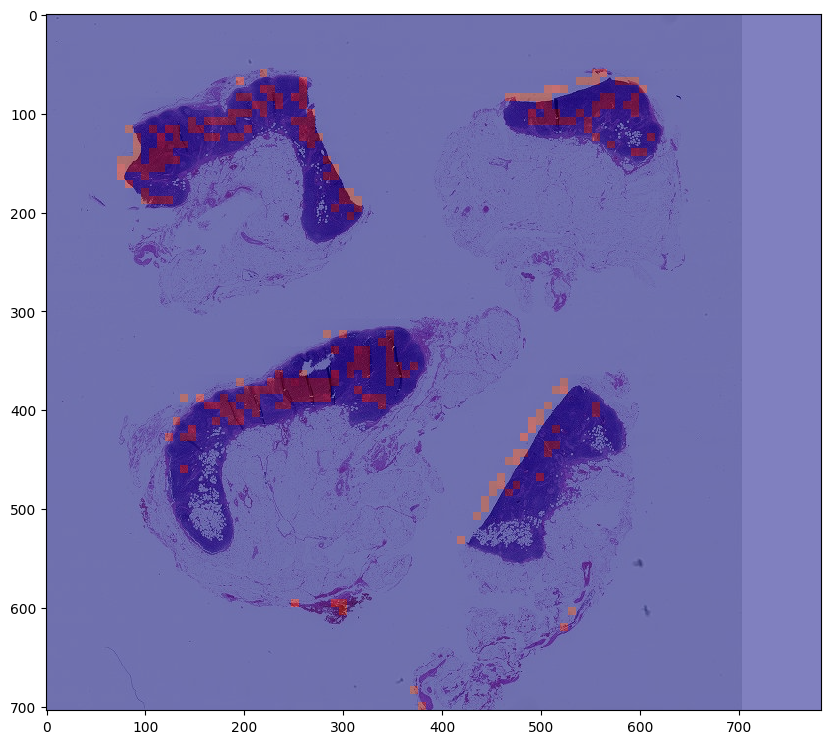

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_3)
plt.imshow(np.where(predicted_mask_3 >=0.95, predicted_mask_3, 0), cmap='jet', alpha=0.5) # Red regions contains cancer.


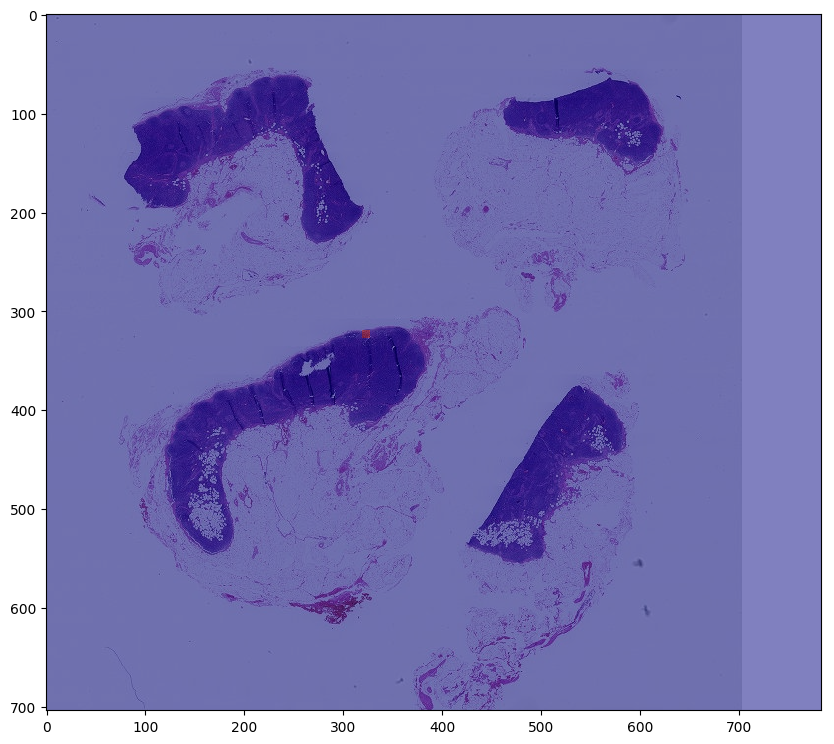

In [0]:
plt.figure(figsize=(10,10), dpi=100)
plt.imshow(slide_img_3)
plt.imshow(actual_mask_3, cmap='jet', alpha=0.5) # Red regions contains cancer.

In [0]:
all_labels= np.concatenate([labels, labels_2, labels_3])

In [0]:
# Total Number of labels
len(all_labels)

13148

In [0]:
# Number of positive samples
sum(all_labels)

1225

In [0]:
all_pred= np.concatenate([predictions, predictions_2, predictions_3])

In [0]:
# Number of positive samples
sum(np.where(all_pred > 0.5,1,0))

2471

## 5. Evaluation

### 5.1. AUC and ROC metrics

AUC: 0.911


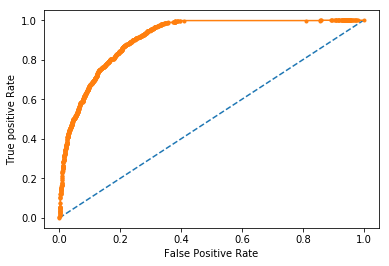

In [0]:
# calculate AUC
auc = roc_auc_score(labels, predictions)
print('AUC: %.3f' % auc)
# calculate roc curve
fpr, tpr, thresholds = roc_curve(labels, predictions)
# plot no skill
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
plt.xlabel('False Positive Rate')
plt.ylabel('True positive Rate')
# show the plot
plt.show()

AUC: 0.942


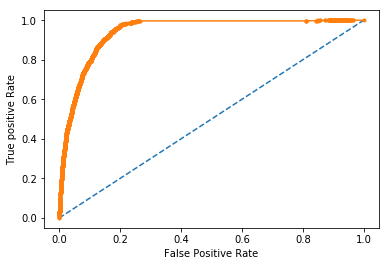

In [0]:
# calculate AUC
auc = roc_auc_score(all_labels, all_pred)
print('AUC: %.3f' % auc)
# calculate roc curve
fpr, tpr, thresholds = roc_curve(all_labels, all_pred)
# plot no skill
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
plt.xlabel('False Positive Rate')
plt.ylabel('True positive Rate')
# show the plot
plt.show()

### 5.2. Confusion Matrix

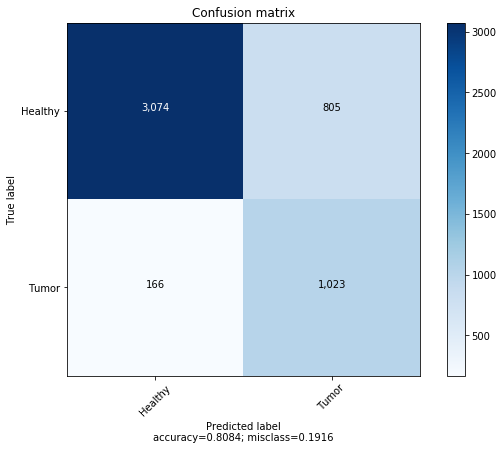

In [0]:
l = [0, 1]
cm = confusion_matrix(labels, np.round(predictions), l)

def plot_confusion_matrix(cm,
                          target_names,
                          title='Confusion matrix',
                          cmap=None,
                          normalize=True):
    """
    given a sklearn confusion matrix (cm), make a nice plot

    Arguments
    ---------
    cm:           confusion matrix from sklearn.metrics.confusion_matrix

    target_names: given classification classes such as [0, 1, 2]
                  the class names, for example: ['high', 'medium', 'low']

    title:        the text to display at the top of the matrix

    cmap:         the gradient of the values displayed from matplotlib.pyplot.cm
                  see http://matplotlib.org/examples/color/colormaps_reference.html
                  plt.get_cmap('jet') or plt.cm.Blues

    normalize:    If False, plot the raw numbers
                  If True, plot the proportions

    Usage
    -----
    plot_confusion_matrix(cm           = cm,                  # confusion matrix created by
                                                              # sklearn.metrics.confusion_matrix
                          normalize    = True,                # show proportions
                          target_names = y_labels_vals,       # list of names of the classes
                          title        = best_estimator_name) # title of graph

    Citiation
    ---------
    http://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html

    """
    import matplotlib.pyplot as plt
    import numpy as np
    import itertools

    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]


    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if normalize:
            plt.text(j, i, "{:0.4f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
        else:
            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")


    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label\naccuracy={:0.4f}; misclass={:0.4f}'.format(accuracy, misclass))
    plt.show()
    
plot_confusion_matrix(cm, ["Healthy","Tumor"], normalize=False)    

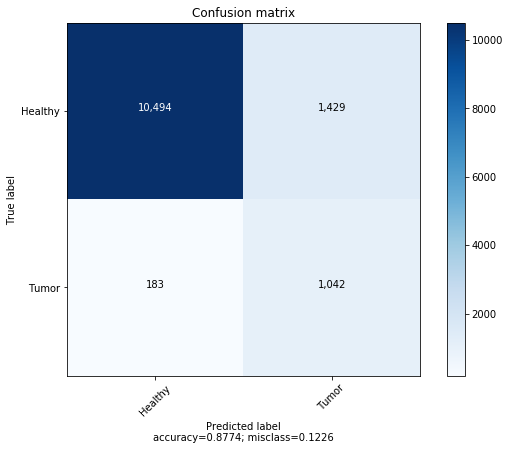

In [0]:
cm_1 = confusion_matrix(all_labels, np.round(all_pred), l)
plot_confusion_matrix(cm_1, ["Healthy","Tumor"], normalize=False) 

### 5.3. Balanced Accuracy Score

In [0]:
from sklearn.metrics import balanced_accuracy_score

In [0]:
balanced_accuracy_score(labels, np.round(predictions))

0.8264295832013444

In [0]:
balanced_accuracy_score(all_labels, np.round(all_pred))

0.8653799293767662

### 5.4 Classification Report Scores

In [0]:
from sklearn.metrics import classification_report

In [0]:
print(classification_report(labels, np.round(predictions)))

              precision    recall  f1-score   support

           0       0.95      0.79      0.86      3879
           1       0.56      0.86      0.68      1189

   micro avg       0.81      0.81      0.81      5068
   macro avg       0.75      0.83      0.77      5068
weighted avg       0.86      0.81      0.82      5068



In [0]:
print(classification_report(all_labels, np.round(all_pred)))

              precision    recall  f1-score   support

           0       0.98      0.88      0.93     11923
           1       0.42      0.85      0.56      1225

   micro avg       0.88      0.88      0.88     13148
   macro avg       0.70      0.87      0.75     13148
weighted avg       0.93      0.88      0.89     13148



### 5.5 Precision, Recall (Sensitivity), Specificity

In [0]:
tn, fp, fn, tp = confusion_matrix(labels, np.round(predictions)).ravel()

In [0]:
all_tn, all_fp, all_fn, all_tp = confusion_matrix(all_labels, np.round(all_pred)).ravel()

In [0]:
precision = tp/(tp+fp)
precision

0.5596280087527352

In [0]:
all_precision = all_tp/(all_tp+all_fp)
all_precision

0.4216916228247673

In [0]:
recall = tp/(tp+fn)
recall

0.8603868797308662

In [0]:
all_recall = all_tp/(all_tp+all_fn)
all_recall

0.8506122448979592

In [0]:
specifity = tn/(tn+fp)
specifity

0.7924722866718227

In [0]:
all_specifity = all_tn/(all_tn+all_fp)
all_specifity

0.8801476138555733

In [0]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png')

Output hidden; open in https://colab.research.google.com to view.